In [1]:
import pandas as pd
import re 
from pprint import pprint

# Gensim for topic modeling
import gensim
from gensim.utils import simple_preprocess
from gensim import matutils, models
import gensim.corpora as corpora
from gensim.models import CoherenceModel

# Plotting tools
import pyLDAvis
import pyLDAvis.gensim_models # don't skip this
import matplotlib.pyplot as plt
%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

# word by freq 
# wordcloud


In [2]:
import pandas as pd
import numpy as np 
import re

# NLTK
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.corpus import wordnet as wn

# spacy for lemmatization
import spacy
import scipy.sparse
from spacy.lang.en import English
nlp = spacy.load("en_core_web_sm")

import warnings
warnings.filterwarnings('ignore')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Shawn\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [3]:
#!pip install https://github.com/explosion/spacy-models/releases/download/en_core_web_sm-3.0.0/en_core_web_sm-3.0.0.tar.gz
#!pip install pyLDAvis

In [4]:
df = pd.read_csv('../topic_posts.csv', names=['Drop','ThreadName', 'ThreadLink', 'User','UserLink','Rank','Date','text']) 
df.head() #Filter by dates and then keep text?

df = df[["Date","text"]]

df["Year"] = df["Date"].str.split("-").str[2]

# drop 
# groupby year 
# LDA 
# bert 

In [5]:
df["Year"].value_counts()

20    64600
17    51584
18    38821
19    37440
21    36761
16    25251
22    15182
14    13625
13    10549
15    10218
12     5048
11     1960
09     1292
10      857
08      493
07      409
05      396
04      336
06      301
03      125
Name: Year, dtype: int64

In [6]:
df_assigned = df

In [7]:
df_assigned = df_assigned.reset_index(drop=True)

# Data cleaning

In [8]:
# Remove non-English words

# remove punc 
df_assigned['clean_text']  = df_assigned['text'].map(lambda x: re.sub("[^A-Za-z0-9]+"," ", str(x)))
# lower case
df_assigned['clean_text']  = df_assigned['clean_text'].apply(lambda x: x.lower())
# tokenize
df_assigned['clean_text']  = [word_tokenize(row) for row in df_assigned['clean_text']]

# remove stopwords
stop_words = stopwords.words('english')
stop_words.extend(['from', 'subject', 're', 'edu', 'use'])
def remove_stopwords(text):
    return [w for w in text if w not in stop_words]
df_assigned['clean_text']  = df_assigned['clean_text'].apply(lambda x: remove_stopwords(x))


In [9]:
# lemmatization & noun extraction 

def lemmatization(text, allowed_postags=['NOUN']): 
    doc = nlp(' '.join(text)) 
    text_out = [token.lemma_ for token in doc if token.pos_ in allowed_postags]
    return text_out

df_assigned['clean_text'] = df_assigned['clean_text'].apply(lambda x: lemmatization(x))


df_assigned.head()

,Date,text,Year,clean_text
0,26-Nov-20,Looking to replace 3x aircons for our HDB flat...,20,"[replace, aircon, hdb, https, www, lazada, pro..."
1,26-Nov-20,"Something just occured to me, do you think tha...",20,"[installation, compressor, balcony, pipe, airc..."
2,26-Nov-20,A freehold semi-detached house at 61 Jalan Kel...,20,"[house, market, knight, singapore, estate, mar..."
3,24-Nov-20,Need some advice here from the property gurus ...,20,"[advice, property, guru, resale, hdb, grant, r..."
4,24-Nov-20,Any grants taken will go back to the CPF accou...,20,"[grant, cpf, account]"


In [10]:
# Import the wordcloud library
from wordcloud import WordCloud

# Join the different processed texts together
description_str = ''
for word_list in df_assigned['clean_text'].values:
    description_str += ' '.join(row for row in word_list) + ' '

description_str

'replace aircon hdb https www lazada product mkttid clk5hhokc1eo1uvppcrdv star energy rating price installation thought lot people city price friday deal aircon mitsubishi system edit nevermind installation charge lol installation compressor balcony pipe aircon wall house market knight singapore estate marketing agent sale storey house plot sq metre frontage kelawar price translate land rate psf https www edgeprop property ne arezone utm campaign advice property guru resale hdb grant retirement bto timer hdb sale amount bto year ehg grant ehg need cpf sale home retirement house house kid kid cpf monie ehg grant kid cpf account interest kid cash sell house work input thank bro grant cpf account bto flexi amount lease demise hdb ownership relative follow law family justice court syariah court property ownership kid hassle trouble time grant cpf monie ehg ehg money refund cpf retirement money case relative friend nuisance neighbor conclusion floor unit resale year fact floor heat material

In [11]:
new_stop_words = stopwords.words('english')
# new_stop_words += ['recipe','time', 'dish']

# Create a WordCloud object
wordcloud = WordCloud(background_color="white", max_words=1000, contour_width=3, stopwords = new_stop_words,
                      contour_color='steelblue', collocations = False,  random_state=1)

# Generate a word cloud
wordcloud.generate(description_str)

# Visualize the word cloud
# wordcloud.to_file("wordcloud_total.png")

# Topic Modeling for Text


## Create Corpus 

In [12]:
data_lemmatized = df_assigned['clean_text'].tolist()
print(data_lemmatized[:10])

[['replace', 'aircon', 'hdb', 'https', 'www', 'lazada', 'product', 'mkttid', 'clk5hhokc1eo1uvppcrdv', 'star', 'energy', 'rating', 'price', 'installation', 'thought', 'lot', 'people', 'city', 'price', 'friday', 'deal', 'aircon', 'mitsubishi', 'system', 'edit', 'nevermind', 'installation', 'charge', 'lol'], ['installation', 'compressor', 'balcony', 'pipe', 'aircon', 'wall'], ['house', 'market', 'knight', 'singapore', 'estate', 'marketing', 'agent', 'sale', 'storey', 'house', 'plot', 'sq', 'metre', 'frontage', 'kelawar', 'price', 'translate', 'land', 'rate', 'psf', 'https', 'www', 'edgeprop', 'property', 'ne', 'arezone', 'utm', 'campaign'], ['advice', 'property', 'guru', 'resale', 'hdb', 'grant', 'retirement', 'bto', 'timer', 'hdb', 'sale', 'amount', 'bto', 'year', 'ehg', 'grant', 'ehg', 'need', 'cpf', 'sale', 'home', 'retirement', 'house', 'house', 'kid', 'kid', 'cpf', 'monie', 'ehg', 'grant', 'kid', 'cpf', 'account', 'interest', 'kid', 'cash', 'sell', 'house', 'work', 'input', 'thank', 

In [13]:
# Create Dictionary
id2word = corpora.Dictionary(data_lemmatized)
# Filter out tokens that appear in only 1 documents and appear in more than 90% of the documents
id2word.filter_extremes(no_below=2, no_above=0.9)
# Create Corpus
texts = data_lemmatized
# Term Document Frequency
corpus = [id2word.doc2bow(text) for text in texts]

In [14]:
# Create a dictionary representation of the documents. Each word gets an id
print('Sample word to id mappings:\n', list(id2word.items())[:50])
print()
print('Total Vocabulary Size:', len(id2word))

Sample word to id mappings:
 [(0, 'aircon'), (1, 'charge'), (2, 'city'), (3, 'clk5hhokc1eo1uvppcrdv'), (4, 'deal'), (5, 'edit'), (6, 'energy'), (7, 'friday'), (8, 'hdb'), (9, 'https'), (10, 'installation'), (11, 'lazada'), (12, 'lol'), (13, 'lot'), (14, 'mitsubishi'), (15, 'mkttid'), (16, 'nevermind'), (17, 'people'), (18, 'price'), (19, 'product'), (20, 'rating'), (21, 'replace'), (22, 'star'), (23, 'system'), (24, 'thought'), (25, 'www'), (26, 'balcony'), (27, 'compressor'), (28, 'pipe'), (29, 'wall'), (30, 'agent'), (31, 'arezone'), (32, 'campaign'), (33, 'edgeprop'), (34, 'estate'), (35, 'frontage'), (36, 'house'), (37, 'kelawar'), (38, 'knight'), (39, 'land'), (40, 'market'), (41, 'marketing'), (42, 'metre'), (43, 'ne'), (44, 'plot'), (45, 'property'), (46, 'psf'), (47, 'rate'), (48, 'sale'), (49, 'singapore')]

Total Vocabulary Size: 35278


## Building LDA Model

### Hyperparameter Tuning for LDA Model

In [15]:
# supporting function
def compute_evaluation_values(corpus, dictionary, k):
    
    lda_model = gensim.models.LdaMulticore(corpus=corpus,
                                           id2word=id2word,
                                           num_topics=k, 
                                           random_state=100,
                                           chunksize=100,
                                           passes=20,
                                           per_word_topics=True)
    
    coherence_model_lda = CoherenceModel(model=lda_model, texts=data_lemmatized, dictionary=id2word, coherence='c_v')
    perplexity = lda_model.log_perplexity(corpus)
    
    return [coherence_model_lda.get_coherence(), perplexity]

In [16]:
# Iterate over possible number of topics.
topic_param = []
coherence_score = []
perplexity_score = []

for k in range(2, 20):
    print('topic number: ', k)
    ev = compute_evaluation_values(corpus=corpus, dictionary=id2word, k=k)
    coherence_score.append(ev[0])
    perplexity_score.append(ev[1])
    print('Coherence Score: ', ev[0])
    print('Perplexity Score: ', ev[1])
    print()
    
    topic_param.append(k)

topic number:  2
Coherence Score:  0.4805094858320007
Perplexity Score:  -7.395763834730267

topic number:  3
Coherence Score:  0.5796169344806771
Perplexity Score:  -7.31221770128544

topic number:  4
Coherence Score:  0.5826995693302105
Perplexity Score:  -7.2964879106004945

topic number:  5
Coherence Score:  0.5569369228418312
Perplexity Score:  -7.326971086765521

topic number:  6
Coherence Score:  0.588377184431638
Perplexity Score:  -7.390499062105181

topic number:  7
Coherence Score:  0.6208810060843274
Perplexity Score:  -7.367506549169635

topic number:  8
Coherence Score:  0.6130696214701266
Perplexity Score:  -7.403289830507163

topic number:  9
Coherence Score:  0.6380190186157028
Perplexity Score:  -7.49343108045018

topic number:  10
Coherence Score:  0.5975578878252517
Perplexity Score:  -7.685253511863542

topic number:  11
Coherence Score:  0.6352325700680042
Perplexity Score:  -7.967728660792451

topic number:  12
Coherence Score:  0.6261258597424276
Perplexity Scor

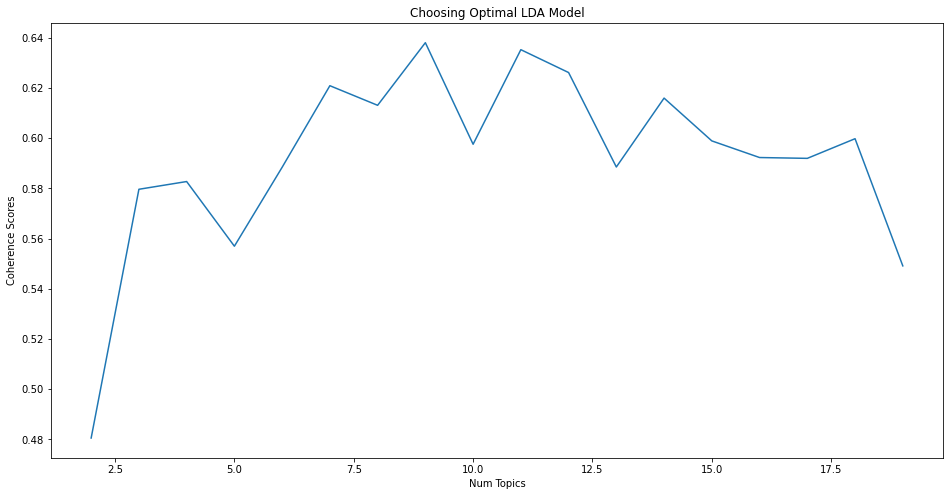

In [17]:
# Show graph
plt.figure(figsize=(16, 8))
plt.plot(topic_param, coherence_score)

plt.title("Choosing Optimal LDA Model")
plt.xlabel("Num Topics")
plt.ylabel("Coherence Scores")
plt.show()

### Final LDA Model

In [31]:
ntopics_des_name = 11

lda_model_des_name = gensim.models.LdaMulticore(corpus=corpus,
                                       id2word=id2word,
                                       num_topics=ntopics_des_name, 
                                       random_state=100,
                                       chunksize=100,
                                       passes=20,
                                       per_word_topics=True)

In [32]:
# Print the Keyword in the topics
pprint(lda_model_des_name.print_topics())
doc_lda = lda_model_des_name[corpus]

[(0,
  '0.136*"u" + 0.030*"parent" + 0.026*"liao" + 0.022*"time" + 0.020*"gagt" + '
  '0.016*"lol" + 0.014*"thread" + 0.013*"rm" + 0.012*"bro" + 0.012*"people"'),
 (1,
  '0.075*"year" + 0.062*"price" + 0.047*"property" + 0.035*"resale" + '
  '0.030*"market" + 0.024*"time" + 0.022*"condo" + 0.018*"people" + '
  '0.017*"buyer" + 0.012*"hdb"'),
 (2,
  '0.058*"owner" + 0.025*"family" + 0.024*"name" + 0.022*"case" + '
  '0.019*"friend" + 0.018*"tenant" + 0.018*"house" + 0.014*"share" + '
  '0.014*"congrat" + 0.012*"person"'),
 (3,
  '0.079*"agent" + 0.055*"buyer" + 0.042*"price" + 0.040*"seller" + '
  '0.032*"unit" + 0.024*"valuation" + 0.014*"resale" + 0.012*"cov" + '
  '0.010*"sale" + 0.009*"fee"'),
 (4,
  '0.043*"www" + 0.042*"singapore" + 0.035*"com" + 0.033*"https" + '
  '0.027*"result" + 0.026*"group" + 0.022*"news" + 0.018*"home" + 0.017*"gov" '
  '+ 0.015*"mr"'),
 (5,
  '0.052*"unit" + 0.032*"psf" + 0.029*"mrt" + 0.027*"area" + 0.021*"price" + '
  '0.018*"bedder" + 0.017*"park" + 0.

In [33]:
def Sort_Tuple(tup):  
    return(sorted(tup, key = lambda x: x[1], reverse = True))

In [34]:
topic_num = []
print(lda_model_des_name.get_document_topics(corpus))
for n in range(len(df_assigned)):
    get_document_topics = lda_model_des_name.get_document_topics(corpus[n])
    sorted_doc_topics = Sort_Tuple(get_document_topics)
    all_topic = []
    for i in sorted_doc_topics:
        all_topic.append(i[0])
    topic_num.append(all_topic)

In [35]:
df_assigned['Topic'] = topic_num

In [36]:
df_assigned

,Date,text,Year,clean_text,Topic
0,26-Nov-20,Looking to replace 3x aircons for our HDB flat...,20,"[replace, aircon, hdb, https, www, lazada, pro...","[8, 7, 5, 4, 3]"
1,26-Nov-20,"Something just occured to me, do you think tha...",20,"[installation, compressor, balcony, pipe, airc...","[7, 0, 1, 2, 3, 4, 5, 6, 8, 9, 10]"
2,26-Nov-20,A freehold semi-detached house at 61 Jalan Kel...,20,"[house, market, knight, singapore, estate, mar...","[4, 2, 9, 5, 8, 1, 3, 10]"
3,24-Nov-20,Need some advice here from the property gurus ...,20,"[advice, property, guru, resale, hdb, grant, r...","[10, 0, 6]"
4,24-Nov-20,Any grants taken will go back to the CPF accou...,20,"[grant, cpf, account]","[10, 8, 0, 1, 2, 3, 4, 5, 6, 7, 9]"
...,...,...,...,...,...
315552,26-Nov-20,"call me a stereotype, if possible i will not l...",20,"[stereotype, flat, studio, apartment, oldie, v...","[7, 0, 6, 3, 5]"
315553,26-Nov-20,Rental flat got many problem one. I will not s...,20,"[rental, problem, bto, unit]","[6, 2, 1, 5, 7, 3, 0, 10, 4, 8, 9]"
315554,26-Nov-20,the estate across the road to mine has rental....,20,"[estate, road, mine, rental, rubbish, dump, da...","[7, 5, 8]"
315555,26-Nov-20,halfnode said:\nthe estate across the road to ...,20,"[halfnode, estate, road, mine, rental, rubbish...","[7, 4, 5, 0, 8]"


In [37]:
des_name_final = df_assigned[['Date', 'text', 'clean_text', 'Topic']]
des_name_final.head()

,Date,text,clean_text,Topic
0,26-Nov-20,Looking to replace 3x aircons for our HDB flat...,"[replace, aircon, hdb, https, www, lazada, pro...","[8, 7, 5, 4, 3]"
1,26-Nov-20,"Something just occured to me, do you think tha...","[installation, compressor, balcony, pipe, airc...","[7, 0, 1, 2, 3, 4, 5, 6, 8, 9, 10]"
2,26-Nov-20,A freehold semi-detached house at 61 Jalan Kel...,"[house, market, knight, singapore, estate, mar...","[4, 2, 9, 5, 8, 1, 3, 10]"
3,24-Nov-20,Need some advice here from the property gurus ...,"[advice, property, guru, resale, hdb, grant, r...","[10, 0, 6]"
4,24-Nov-20,Any grants taken will go back to the CPF accou...,"[grant, cpf, account]","[10, 8, 0, 1, 2, 3, 4, 5, 6, 7, 9]"


In [39]:
# des_name_final.to_csv('description_name_features_final_all_noun.csv', index=False) 

### Model Evaluation

In [40]:
# Compute Perplexity
perplexity = lda_model_des_name.log_perplexity(corpus)
print('Perplexity: ', perplexity)  # a measure of how good the model is. lower the better.

# Compute Coherence Score
coherence_model_lda = CoherenceModel(model=lda_model_des_name, texts=data_lemmatized, dictionary=id2word, coherence='c_v')
coherence_lda = coherence_model_lda.get_coherence()
print('Coherence Score: ', coherence_lda)

Perplexity:  -7.975717088155361
Coherence Score:  0.6087092971261423


## Visualisation

In [41]:
import pyLDAvis
import pyLDAvis.gensim_models as gensimvis
pyLDAvis.enable_notebook()

# # feed the LDA model into the pyLDAvis instance
# lda_viz = gensimvis.prepare(ldamodel, corpus, dictionary)

In [42]:
# Visualize the topics
pyLDAvis.enable_notebook()
vis = gensimvis.prepare(lda_model_des_name, corpus, id2word)
vis

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
5      0.190289 -0.172698       1        1  12.479592
7      0.008891 -0.182078       2        1  12.298572
1     -0.102369  0.068077       3        1  11.684405
10    -0.155597  0.144385       4        1  10.783305
6      0.019440 -0.235309       5        1  10.467517
3     -0.142671  0.010305       6        1   9.283955
8     -0.133476 -0.047605       7        1   8.570027
0     -0.088245 -0.056324       8        1   8.557370
2     -0.125742  0.107478       9        1   5.602851
4      0.167146  0.305627      10        1   5.485413
9      0.362333  0.058142      11        1   4.786992, topic_info=             Term           Freq          Total Category  logprob  loglift
144             u   65006.000000   65006.000000  Default  30.0000  30.0000
110          unit  134673.000000  134673.000000  Default  29.0000  29.0000
76           year   72563.000000   72563.000000  Default  28.0000  28.0000
574          loan   44740.000000   44740.000000  Default  27.0000  27.0000
30          agent   41241.000000   41241.000000  Default  26.0000  26.0000
...           ...            ...            ...      ...      ...      ...
1016  development    2588.300979   13366.689075  Topic11  -4.6402   1.3975
1509          top    1974.628924    5110.845898  Topic11  -4.9109   2.0883
394       quality    1603.626876    3293.217559  Topic11  -5.1190   2.3197
362          cost    1840.387281    8922.823145  Topic11  -4.9813   1.4606
114         condo    1667.972150   23937.865482  Topic11  -5.0796   0.3754

[590 rows x 6 columns], token_table=       Topic      Freq        Term
term                              
34201      5  0.998989        170b
2077       1  0.999607  1993newbie
777        1  0.166614          1k
777        6  0.833070          1k
1062       6  0.999294         1st
...      ...       ...         ...
25        10  0.999900         www
2439       2  0.999200        yard
76         2  0.052671        year
76         3  0.675601        year
76         4  0.271721        year

[863 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[6, 8, 2, 11, 7, 4, 9, 1, 3, 5, 10])

## Word Count of Topic Keywords

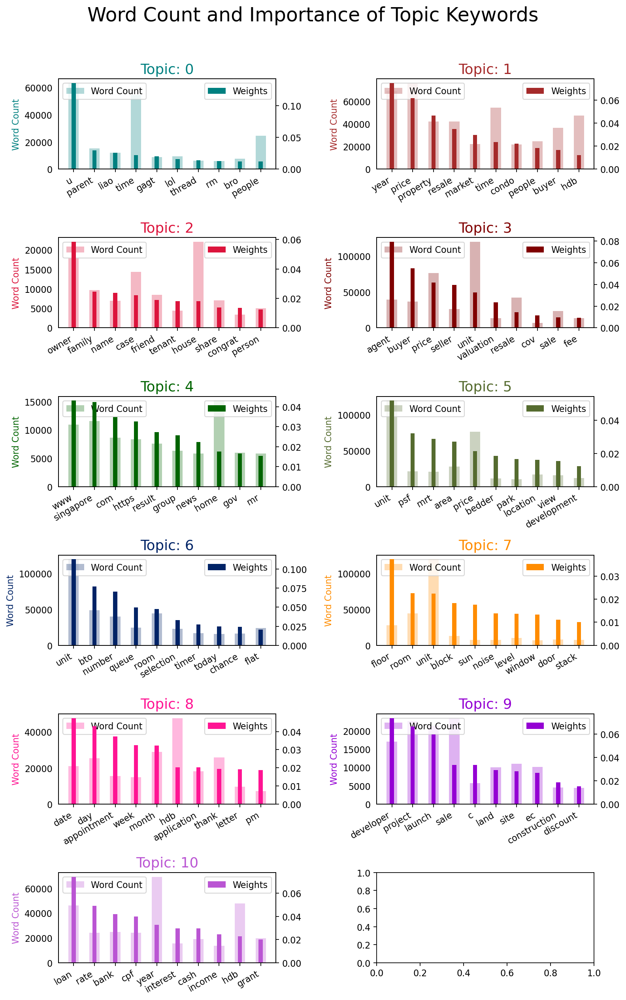

In [43]:
from collections import Counter

topics = lda_model_des_name.show_topics(num_topics=ntopics_des_name, formatted=False)
data_flat = [w for w_list in data_lemmatized for w in w_list]
counter = Counter(data_flat)

out = []
for i, topic in topics:
    for word, weight in topic:
        out.append([word, i , weight, counter[word]])

df = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count'])        

# Plot Word Count and Weights of Topic Keywords
fig, axes = plt.subplots(6, 2, figsize=(10,15), dpi=160,facecolor='white')
cols = ['#008080', '#A52A2A', '#DC143C', '#800000', '#006400', '#556b2f', '#002366', '#ff8c00', '#FF1493', '#9400D3',
        '#ba55d3', '#b8860b', '#C71585', '#00ff7f', '#00004C', '#00008B', '#B8860B', '#DEB887', '#8A2BE2', '#1b364a']

for i, ax in enumerate(axes.flatten()):
    if i > ntopics_des_name - 1: # break when all topics are shown
        break
    ax.bar(x='word', height="word_count", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.5, alpha=0.3, label='Word Count')
    ax_twin = ax.twinx()
    ax_twin.bar(x='word', height="importance", data=df.loc[df.topic_id==i, :], color=cols[i], width=0.2, label='Weights')
    ax.set_ylabel('Word Count', color=cols[i])
    ax.set_title('Topic: ' + str(i), color=cols[i], fontsize=16)
    ax.tick_params(axis='y', left=False)
    ax.set_xticklabels(df.loc[df.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper left'); ax_twin.legend(loc='upper right')


fig.tight_layout(w_pad=2)    
fig.suptitle('Word Count and Importance of Topic Keywords', fontsize=22, y=1.05)   
plt.savefig('lda_topics_all.png',facecolor=fig.get_facecolor(), transparent=True)
plt.show()
